In [ ]:
!pip install timm
!pip install torch torchvision -U
!pip install open3d

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 399.7/399.7 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 49.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 15.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 61.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 56.5 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.6
    Uninstalling widgetsnbextension-3.6.6:
      Successfully uninstalled widgetsnbextension-3.6.6
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1


/usr/local/lib/python3.10/dist-packages/torch/hub.py:293: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/intel-isl/MiDaS/zipball/master" to /root/.cache/torch/hub/master.zip


Loading weights:  None


/usr/local/lib/python3.10/dist-packages/torch/hub.py:293: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/rwightman/gen-efficientnet-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_lite3-b733e338.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_lite3-b733e338.pth
Downloading: "https://github.

[[[ 54  50  48]
  [ 54  50  48]
  [ 54  50  48]
  ...
  [ 59  49  46]
  [ 59  49  46]
  [ 59  49  46]]

 [[ 54  50  48]
  [ 54  50  48]
  [ 54  50  48]
  ...
  [ 59  49  46]
  [ 59  49  46]
  [ 59  49  46]]

 [[ 54  50  48]
  [ 54  50  48]
  [ 54  50  48]
  ...
  [ 59  49  46]
  [ 59  49  46]
  [ 59  49  46]]

 ...

 [[  7 119  91]
  [  6 115  88]
  [ 12 119  93]
  ...
  [ 30 133 116]
  [ 30 133 116]
  [ 30 133 116]]

 [[ 10 119  93]
  [  7 116  89]
  [ 13 120  94]
  ...
  [ 31 132 115]
  [ 31 132 115]
  [ 31 132 115]]

 [[ 10 119  93]
  [  7 116  89]
  [ 13 120  94]
  ...
  [ 29 131 114]
  [ 29 131 114]
  [ 29 131 114]]]
Image resolution: (534, 800)
Data type: float32
Min value: -47.76926040649414
Max value: 856.653076171875


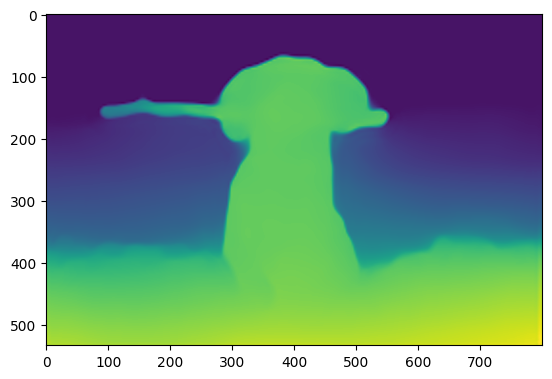

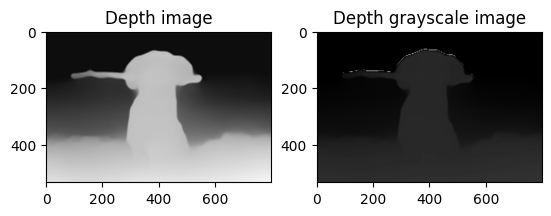

In [ ]:
import cv2
import torch
import urllib.request
import numpy as np
import open3d as o3d

import matplotlib.pyplot as plt

url, filename = ("https://github.com/Prateek-Main/Images/blob/main/dog1.jpeg?raw=true", "dog1.jpeg")
urllib.request.urlretrieve(url, filename)


#model_type = "DPT_Large"     # MiDaS v3 - Large     (highest accuracy, slowest inference speed)
#model_type = "DPT_Hybrid"   # MiDaS v3 - Hybrid    (medium accuracy, medium inference speed)
model_type = "MiDaS_small"  # MiDaS v2.1 - Small   (lowest accuracy, highest inference speed)

midas = torch.hub.load("intel-isl/MiDaS", model_type)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
midas.to(device)
midas.eval()
midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms")

if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
    transform = midas_transforms.dpt_transform
else:
    transform = midas_transforms.small_transform
img = cv2.imread(filename)
print(img)

img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

input_batch = transform(img).to(device)
with torch.no_grad():
    prediction = midas(input_batch)

    prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),
        size=img.shape[:2],
        mode="bicubic",
        align_corners=False,
    ).squeeze()

depth_image = prediction.cpu().numpy()
plt.imshow(depth_image)
# plt.show()
def compute_pcd_nested_loops(depth_im):
  height, width = depth_im.shape
  pcd = []
  for i in range(height):
    for j in range(width):
      z = depth_image[i][j]
      x = (j - CX_DEPTH) * depth_im[i][j] / FX_DEPTH
      y = (i - CY_DEPTH) * depth_im[i][j] / FY_DEPTH
      pcd.append([x, y, z])
  return pcd

def compute_pcd_vectorization(depth_im):
  # get depth resolution:
  height, width = depth_im.shape
  # compute indices:
  jj = np.tile(range(width), height)
  ii = np.repeat(range(height), width)
  # rechape depth image
  z = depth_im.reshape(height * width)
  # compute pcd:
  pcd = np.dstack([(ii - CX_DEPTH) * z / FX_DEPTH,
                  (jj - CY_DEPTH) * z / FY_DEPTH,
                  z]).reshape((length, 3))
  return pcd

if __name__ == '__main__':
  # Camera parameters:
  FX_DEPTH = 5.8262448167737955e+02
  FY_DEPTH = 5.8269103270988637e+02
  CX_DEPTH = 3.1304475870804731e+02
  CY_DEPTH = 2.3844389626620386e+02

  # Read depth image:

  # print some properties:
  print(f"Image resolution: {depth_image.shape}")
  print(f"Data type: {depth_image.dtype}")
  print(f"Min value: {np.min(depth_image)}")
  print(f"Max value: {np.max(depth_image)}")

  # Compute depth grayscale:
  depth_grayscale = np.array(256 * depth_image / 0x0fff, dtype=np.uint8)

  # Display depth and grayscale image:
  fig, axs = plt.subplots(1, 2)
  axs[0].imshow(depth_image, cmap="gray")
  axs[0].set_title('Depth image')
  axs[1].imshow(depth_grayscale, cmap="gray")
  axs[1].set_title('Depth grayscale image')
  plt.show()

  # get depth image resolution:
  height, width = depth_image.shape
  # compute indices:
  jj = np.tile(range(width), height)
  ii = np.repeat(range(height), width)
  # Compute constants:
  xx = (jj - CX_DEPTH) / FX_DEPTH
  yy = (ii - CY_DEPTH) / FY_DEPTH
  # transform depth image to vector of z:
  length = height * width
  z = depth_image.reshape(length)
  # compute point cloud
  pcd = np.dstack((xx * z, yy * z, z)).reshape((length, 3))

  # Convert to Open3D.PointCLoud:
  # Convert to Open3D.PointCloud:
  pcd_o3d = o3d.geometry.PointCloud()  # create point cloud object
  pcd_o3d.points = o3d.utility.Vector3dVector(pcd)  # set pcd_np as the point cloud points

  # Colorize the point cloud based on depth
  colors = plt.cm.jet(depth_image / np.max(depth_image))
  pcd_o3d.colors = o3d.utility.Vector3dVector(colors[:, :, :3].reshape(-1, 3))
  # pcd_o3d = o3d.geometry.PointCloud()  # create point cloud object
  # pcd_o3d.points = o3d.utility.Vector3dVector(pcd)  # set pcd_np as the point cloud points
  # Visualize:
  o3d.visualization.draw_plotly([pcd_o3d])

In [ ]:
import cv2
import torch
import urllib.request
import numpy as np
import open3d as o3d

import matplotlib.pyplot as plt

url, filename = ("https://github.com/Prateek-Main/Images/blob/main/dog1.jpeg?raw=true", "dog1.jpeg")
urllib.request.urlretrieve(url, filename)


#model_type = "DPT_Large"     # MiDaS v3 - Large     (highest accuracy, slowest inference speed)
#model_type = "DPT_Hybrid"   # MiDaS v3 - Hybrid    (medium accuracy, medium inference speed)
model_type = "MiDaS_small"  # MiDaS v2.1 - Small   (lowest accuracy, highest inference speed)

midas = torch.hub.load("intel-isl/MiDaS", model_type)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
midas.to(device)
midas.eval()
midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms")

if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
    transform = midas_transforms.dpt_transform
else:
    transform = midas_transforms.small_transform
img = cv2.imread(filename)
print(img)

img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

input_batch = transform(img).to(device)
with torch.no_grad():
    prediction = midas(input_batch)

    prediction = torch.nn.functional.interpolate(
        prediction.unsqueeze(1),
        size=img.shape[:2],
        mode="bicubic",
        align_corners=False,
    ).squeeze()

depth_image = prediction.cpu().numpy()
# plt.imshow(depth_image)
# plt.show()
def compute_pcd_nested_loops(depth_im):
  height, width = depth_im.shape
  pcd = []
  for i in range(height):
    for j in range(width):
      z = depth_image[i][j]
      x = (j - CX_DEPTH) * depth_im[i][j] / FX_DEPTH
      y = (i - CY_DEPTH) * depth_im[i][j] / FY_DEPTH
      pcd.append([x, y, z])
  return pcd

def compute_pcd_vectorization(depth_im):
  # get depth resolution:
  height, width = depth_im.shape
  # compute indices:
  jj = np.tile(range(width), height)
  ii = np.repeat(range(height), width)
  # rechape depth image
  z = depth_im.reshape(height * width)
  # compute pcd:
  pcd = np.dstack([(ii - CX_DEPTH) * z / FX_DEPTH,
                  (jj - CY_DEPTH) * z / FY_DEPTH,
                  z]).reshape((length, 3))
  return pcd

if __name__ == '__main__':
  # Camera parameters:
  FX_DEPTH = 5.8262448167737955e+02
  FY_DEPTH = 5.8269103270988637e+02
  CX_DEPTH = 3.1304475870804731e+02
  CY_DEPTH = 2.3844389626620386e+02

  # Read depth image:

  # print some properties:
  print(f"Image resolution: {depth_image.shape}")
  print(f"Data type: {depth_image.dtype}")
  print(f"Min value: {np.min(depth_image)}")
  print(f"Max value: {np.max(depth_image)}")

  # Compute depth grayscale:
  depth_grayscale = np.array(256 * depth_image / 0x0fff, dtype=np.uint8)


  # Display depth_image and Original Image
  fig, axs = plt.subplots(1, 2)
  axs[0].imshow(img)
  axs[0].set_title('Original Image')
  axs[1].imshow(depth_image)
  axs[1].set_title('HeatMap')
  plt.show()
  # Display depth and grayscale image:
  fig, axs = plt.subplots(1, 2)
  axs[0].imshow(depth_image, cmap="gray")
  axs[0].set_title('Depth image')
  axs[1].imshow(depth_grayscale, cmap="gray")
  axs[1].set_title('Depth grayscale image')
  plt.show()

  # get depth image resolution:
  height, width = depth_image.shape
  # compute indices:
  jj = np.tile(range(width), height)
  ii = np.repeat(range(height), width)
  # Compute constants:
  xx = (jj - CX_DEPTH) / FX_DEPTH
  yy = (ii - CY_DEPTH) / FY_DEPTH
  # transform depth image to vector of z:
  length = height * width
  z = depth_image.reshape(length)
  # compute point cloud
  pcd = np.dstack((xx * z, yy * z, z)).reshape((length, 3))

  # Convert to Open3D.PointCLoud:
  # Convert to Open3D.PointCloud:
  pcd_o3d = o3d.geometry.PointCloud()  # create point cloud object
  pcd_o3d.points = o3d.utility.Vector3dVector(pcd)  # set pcd_np as the point cloud points

  # Colorize the point cloud based on depth
  colors = plt.cm.jet(depth_image / np.max(depth_image))
  pcd_o3d.colors = o3d.utility.Vector3dVector(colors[:, :, :3].reshape(-1, 3))
  # pcd_o3d = o3d.geometry.PointCloud()  # create point cloud object
  # pcd_o3d.points = o3d.utility.Vector3dVector(pcd)  # set pcd_np as the point cloud points
  # Visualize:
  o3d.visualization.draw_plotly([pcd_o3d])